In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster

In [4]:
df = pd.read_csv('cat_acidentes.csv', sep=';')
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2025-06-01 01:33:13,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2025-06-01 01:33:13,598.0,0.0,2020-01-01 00:00:00,1,0,0,0,0,0,...,NaN,NaN,AV BENTO GONCALVES,NaN,ABALROAMENTO,QUARTA-FEIRA,03:00:00.0000000,NOITE,LESTE,NaN
2,2025-06-01 01:33:13,1271.0,0.0,2020-01-01 00:00:00,1,1,0,0,0,1,...,NaN,NaN,AV INDEPENDENCIA,NaN,ATROPELAMENTO,QUARTA-FEIRA,23:00:00.0000000,NOITE,LESTE,NaN
3,2025-06-01 01:33:13,1901.0,0.0,2020-01-02 00:00:00,2,0,0,0,0,0,...,NaN,NaN,AV EDUARDO PRADO,NaN,ATROPELAMENTO,QUINTA-FEIRA,00:05:00.0000000,NOITE,SUL,NaN
4,2025-06-01 01:33:13,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69516,2025-06-01 01:33:13,NaN,0.0,2025-03-30 00:00:00,0,0,0,0,0,2,...,NaN,NaN,R PADRE ANGELO CORSO,R CEL MASSOT,COLISÃO,DOMINGO,13:25:00.0000000,DIA,SUL,NaN
69517,2025-06-01 01:33:13,668.0,0.0,2025-03-31 00:00:00,0,0,0,0,0,2,...,-51.249116,-30.101305,R DR CASTRO DE MENEZES,NaN,EVENTUAL,SEGUNDA-FEIRA,07:00:00.0000000,DIA,SUL,NaN
69518,2025-06-01 01:33:13,NaN,0.0,2025-03-31 00:00:00,0,0,0,0,0,2,...,NaN,NaN,AV JULIO DE CASTILHOS,R CHAVES BARCELOS,COLISÃO,SEGUNDA-FEIRA,15:30:00.0000000,DIA,CENTRO,NaN
69519,2025-06-01 01:33:13,NaN,0.0,2025-03-31 00:00:00,0,0,0,0,0,2,...,NaN,NaN,AV JOSE BONIFACIO,R SANTANA,ABALROAMENTO,SEGUNDA-FEIRA,14:50:00.0000000,DIA,CENTRO,NaN


## Remover linhas em branco

In [5]:
df = df.dropna(subset=['latitude', 'longitude'], how='any')
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2025-06-01 01:33:13,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
4,2025-06-01 01:33:13,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
6,2025-06-01 01:33:13,11000.0,0.0,2020-01-02 00:00:00,1,1,0,0,0,2,...,-51.114792,-29.975967,AV ASSIS BRASIL,NaN,COLISÃO,QUINTA-FEIRA,14:15:00.0000000,DIA,NORTE,NaN
8,2025-06-01 01:33:13,1028.0,0.0,2020-01-02 00:00:00,0,0,0,0,0,2,...,-51.180252,-30.037807,AV BAGE,AV PALMEIRA,ABALROAMENTO,QUINTA-FEIRA,21:30:00.0000000,NOITE,LESTE,NaN
11,2025-06-01 01:33:13,5800.0,0.0,2020-01-02 00:00:00,0,0,0,0,0,1,...,-51.153991,-30.041495,AV PROTASIO ALVES,AV SATURNINO DE BRITO,ABALROAMENTO,QUINTA-FEIRA,07:10:00.0000000,DIA,LESTE,CARRIS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69512,2025-06-01 01:33:13,NaN,0.0,2025-03-28 00:00:00,0,0,0,0,0,1,...,-51.148981,-30.010510,AV BOGOTA,AV ASSIS BRASIL,COLISÃO,SEXTA-FEIRA,14:25:00.0000000,DIA,NORTE,NaN
69514,2025-06-01 01:33:13,374.0,0.0,2025-03-28 00:00:00,0,0,0,0,0,2,...,-51.094351,-29.999705,AV GAMAL ABDEL NASSER,NaN,COLISÃO,SEXTA-FEIRA,07:45:00.0000000,DIA,NORTE,NaN
69515,2025-06-01 01:33:13,1870.0,0.0,2025-03-28 00:00:00,0,0,0,0,0,2,...,-51.209379,-30.045120,AV IPIRANGA,NaN,COLISÃO,SEXTA-FEIRA,13:10:00.0000000,DIA,CENTRO,NaN
69517,2025-06-01 01:33:13,668.0,0.0,2025-03-31 00:00:00,0,0,0,0,0,2,...,-51.249116,-30.101305,R DR CASTRO DE MENEZES,NaN,EVENTUAL,SEGUNDA-FEIRA,07:00:00.0000000,DIA,SUL,NaN


In [6]:
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=12)

coordenadas = list(zip(df['latitude'], df['longitude']))
mapa_calor = HeatMap(coordenadas, radius=9, blur=10)
mapa.add_child(mapa_calor)
mapa.save('mapa_calor.html')
mapa

In [7]:
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=12)
mapa_cluster = MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)

mapa

In [8]:
df.data

0        2020-10-17 00:00:00
4        2020-01-02 00:00:00
6        2020-01-02 00:00:00
8        2020-01-02 00:00:00
11       2020-01-02 00:00:00
                ...         
69512    2025-03-28 00:00:00
69514    2025-03-28 00:00:00
69515    2025-03-28 00:00:00
69517    2025-03-31 00:00:00
69520    2025-03-31 00:00:00
Name: data, Length: 59218, dtype: object

In [10]:
df = df.copy()
df['data'] = pd.to_datetime(df['data'])

In [11]:
df['data'] = pd.to_datetime(df['data'])
df_ano= df['data'].dt.year.value_counts()
df_ano

data
2023    14572
2024    13693
2022    13328
2021    11701
2025     3023
2020     2896
2027        2
2026        2
2202        1
Name: count, dtype: int64

In [12]:
df_ano = df_ano.drop(2202)
df_ano

data
2023    14572
2024    13693
2022    13328
2021    11701
2025     3023
2020     2896
2027        2
2026        2
Name: count, dtype: int64

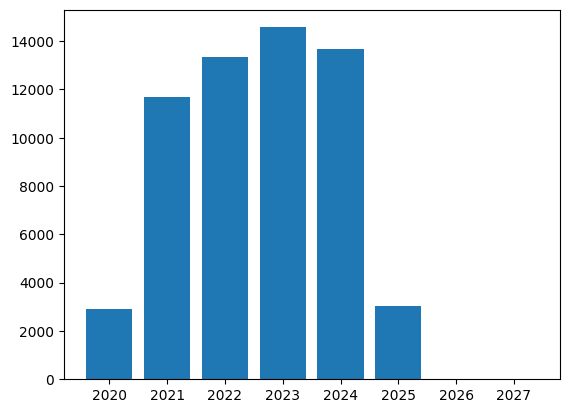

In [14]:
plt.bar(df_ano.index, df_ano.values)
plt.show()

In [16]:
df_ano/df_ano.max()

data
2023    1.000000
2024    0.939679
2022    0.914631
2021    0.802978
2025    0.207453
2020    0.198737
2027    0.000137
2026    0.000137
Name: count, dtype: float64

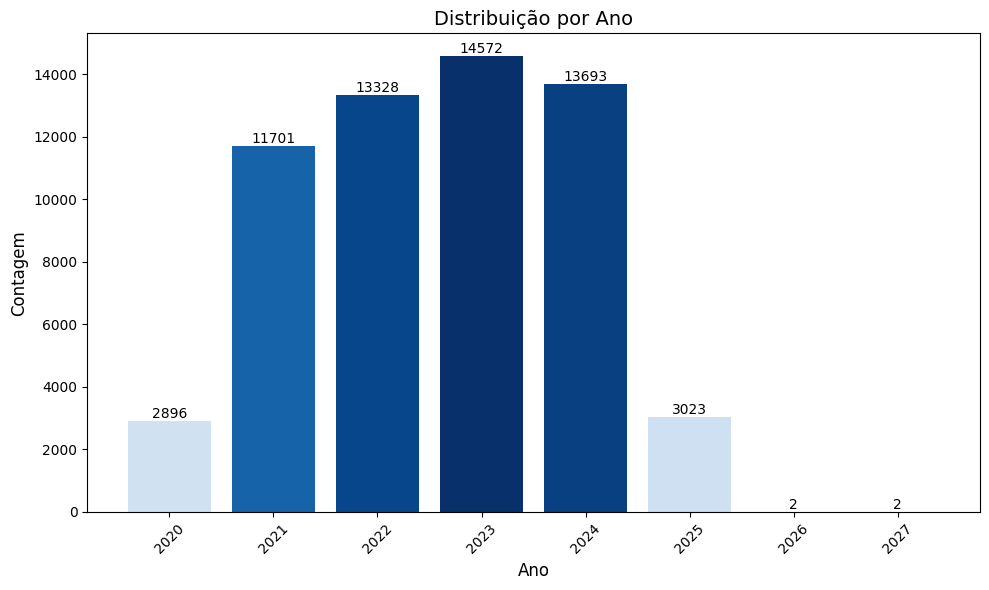

In [ ]:
gradiente = df_ano / df_ano.max()
cores = plt.cm.Blues(gradiente)

plt.figure(figsize=(10, 6))  # Ajuste o tamanho se necessário

# Criar o gráfico de barras
bars = plt.bar(df_ano.index, df_ano.values, color=cores)

# Adicionar rótulos nas colunas (valores em cima de cada barra)
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height)}',
             ha='center', va='bottom')

# Adicionar títulos e labels dos eixos
plt.title('Distribuição por Ano', fontsize=14)
plt.xlabel('Ano', fontsize=12)
plt.ylabel('Contagem', fontsize=12)

# Melhorar a legibilidade dos anos no eixo X
plt.xticks(df_ano.index, rotation=45 if len(df_ano) > 5 else 0)

plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()  # Ajusta o layout para evitar cortes
plt.show()

---